# Анализ тональности комментариев Youtube (Sentiment analysis)

## Загрузка необходимых библиотек

In [22]:
!pip install selenium

In [23]:
!pip install wordcloud

In [24]:
import re
import time
from tqdm import tqdm
 
import numpy as np
import pandas as pd
 

import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from selenium import webdriver

import nltk
from nltk.corpus import stopwords as nltk_stopwords
from pymystem3 import Mystem
from wordcloud import WordCloud

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split

from sklearn.linear_model import LogisticRegression

from sklearn.metrics import *

In [25]:
comments_putin_df = pd.read_csv('comments_putin.csv')

comments_putin_df

,Unnamed: 0,comment
0,0,Народ тебя никогда не забудет
1,1,"Желаю путину всего того , что он сделал для на..."
2,2,"Зашёл сюда не послушать, а почитать! Сильно у..."
3,3,"2046 год. Путин: ""Год был непростым, прошу отн..."
4,4,"Я ждал что он скажет ""уходящий год был непрост..."
...,...,...
3339,3339,Лучший президент России
3340,3340,Благослови навеки Путина и Россию!
3341,3341,В коментах вижувсе недовольные. Так идите рабо...
3342,3342,Сами лучи президента России.


for _ in range(10):

    print(comments_shulman[np.random.randint(len(comments_shulman))])

In [26]:
comments_shulman_df = pd.read_csv('comments_shulman.csv')


comments_shulman_df

,Unnamed: 0,comment
0,0,Новогоднее обращение которое приятно смотреть!...
1,1,"С Новым годом, Екатерина Михайловна!!! Вы - лу..."
2,2,"Невероятная умница Екатерина! Дарит крылья, си..."
3,3,"С Новым годом, уважаемая Екатерина Михайловна!..."
4,4,"В этом году я открыла для себя вас, Екатерина ..."
...,...,...
2249,2249,Вам предстоит побороться с Алексеем Анатольеви...
2250,2250,Екатерину Михайловну в президенты! Ура! У снов...
2251,2251,Ну вот это я понимаю. Куда приятнее видеть так...
2252,2252,С Новым годищщем! Это же будет интересный год)


## Загрузка размеченного датасета study.mokoron
Источник https://study.mokoron.com/

In [27]:
positive = pd.read_csv('russian_sentiment_tweet_automated_labeled\\positive.csv',
                       sep = ';',
                       header= None
                      )

In [28]:
negative = pd.read_csv('russian_sentiment_tweet_automated_labeled\\negative.csv',
                       sep = ';',
                       header= None
                      )

In [29]:
positive_text = pd.DataFrame(positive.iloc[:, 3])
negative_text = pd.DataFrame(negative.iloc[:, 3])

In [30]:
positive_text['label'] = [1] * positive_text.shape[0]
negative_text['label'] = [0] * negative_text.shape[0]

In [31]:
labeled_tweets = pd.concat([positive_text, negative_text])

In [32]:
labeled_tweets.index = range(labeled_tweets.shape[0])

In [33]:
labeled_tweets.columns = ['text', 'label']
labeled_tweets

,text,label
0,"@first_timee хоть я и школота, но поверь, у на...",1
1,"Да, все-таки он немного похож на него. Но мой ...",1
2,RT @KatiaCheh: Ну ты идиотка) я испугалась за ...,1
3,"RT @digger2912: ""Кто то в углу сидит и погибае...",1
4,@irina_dyshkant Вот что значит страшилка :D\nН...,1
...,...,...
226829,Но не каждый хочет что то исправлять:( http://...,0
226830,скучаю так :-( только @taaannyaaa вправляет мо...,0
226831,"Вот и в школу, в говно это идти уже надо(",0
226832,"RT @_Them__: @LisaBeroud Тауриэль, не грусти :...",0


### Очистка размеченного датасета

Напишем фукнцию для очистки текстов от лишних символов

In [34]:
# Оставим в тексте только кириллические символы
def clear_text(text):
    clear_text = re.sub(r'[^А-яЁё]+', ' ', text).lower()
    return " ".join(clear_text.split())
    

# напишем функцию удаляющую стоп-слова
def clean_stop_words(text, stopwords):
    text = [word for word in text.split() if word not in stopwords]
    return " ".join(text)

In [35]:
# загрузим список стоп-слов
stopwords = set(nltk_stopwords.words('russian'))
np.array(stopwords)

array({'чем', 'какой', 'том', 'когда', 'тогда', 'но', 'хоть', 'конечно', 'что', 'раз', 'перед', 'этой', 'да', 'ей', 'лучше', 'тем', 'нас', 'чтобы', 'чего', 'чуть', 'на', 'вдруг', 'их', 'был', 'была', 'сам', 'к', 'меня', 'больше', 'себя', 'там', 'ну', 'тоже', 'кто', 'один', 'впрочем', 'даже', 'себе', 'под', 'ни', 'ему', 'эту', 'моя', 'в', 'или', 'тот', 'об', 'а', 'про', 'при', 'ведь', 'этом', 'нельзя', 'ж', 'ее', 'мы', 'если', 'него', 'опять', 'будто', 'зачем', 'быть', 'над', 'никогда', 'ли', 'она', 'разве', 'по', 'другой', 'он', 'вот', 'я', 'о', 'они', 'нибудь', 'есть', 'надо', 'бы', 'ты', 'до', 'всю', 'совсем', 'были', 'можно', 'свою', 'ним', 'более', 'почти', 'через', 'всегда', 'хорошо', 'мой', 'уж', 'за', 'такой', 'было', 'им', 'между', 'какая', 'вас', 'всех', 'того', 'всего', 'во', 'наконец', 'после', 'здесь', 'уже', 'нет', 'только', 'его', 'мне', 'может', 'же', 'не', 'два', 'много', 'потому', 'них', 'ничего', 'еще', 'от', 'где', 'и', 'потом', 'ней', 'иногда', 'чтоб', 'с', 'эти', '

In [36]:
# Протестируем работу функции очистки текста
text = labeled_tweets['text'][np.random.randint(labeled_tweets.shape[0])]
print(text)
print('=======================================')
print(clean_stop_words((clear_text(text)), stopwords))

Вот дела, ещё и тренера в армию забрали :(
дела ещё тренера армию забрали


In [37]:
start_clean = time.time()

labeled_tweets['text_clear'] = labeled_tweets['text'].apply(lambda x: clean_stop_words(clear_text(str(x)), stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 2.12 секунд


In [38]:
labeled_tweets = labeled_tweets[['text_clear', 'label']]
labeled_tweets

,text_clear,label
0,школота поверь самое общество профилирующий пр...,1
1,таки немного похож мальчик равно,1
2,идиотка испугалась,1
3,углу сидит погибает голода ещё порции взяли хо...,1
4,значит страшилка блин посмотрев части создастс...,1
...,...,...
226829,каждый хочет исправлять,0
226830,скучаю вправляет мозги равно скучаю,0
226831,школу говно это идти,0
226832,тауриэль грусти обнял,0


In [39]:
labeled_tweets.to_csv('\\labeled_tweets_clean.csv')

## Загрузка размеченного датасета  Linis Crowd
Источник http://www.linis-crowd.org/

In [40]:
labeled_texts_1 = pd.read_excel('doc_comment_summary.xlsx',
    sheet_name = 0,
    header=None
    )

In [41]:
labeled_texts_1

,0,1
0,Но при мужчине ни одна приличная женщина не по...,-1
1,Украина это часть Руси искусственно отделенная...,-1
2,Как можно говорить об относительно небольшой к...,-1
3,1.2014. а что они со своими поляками сделали?...,0
4,у а фильмы... Зрители любят диковинное. у ме...,0
...,...,...
26868,Многих заставляют. Многие сами проявляют излиш...,-1
26869,Очередной Чубайс. ну а чего нового то? Сорос ...,-1
26870,"Закон, как все предыдущие - абсолютный бред и ...",0
26871,дело которое ты делаешь сейчас - оно очень хор...,0


In [42]:
labeled_texts_1['label'] = pd.to_numeric(labeled_texts_1.iloc[:, 1], errors='coerce')

In [43]:
labeled_texts_1 = labeled_texts_1[[0, 'label']]

In [44]:
labeled_texts_1.columns = ['text', 'label']

In [45]:
labeled_texts_1.label.value_counts()

 0.0        13930
-1.0         9203
 1.0         1795
-2.0         1534
 2.0          365
 22158.0        2
 21887.0        1
 23486.0        1
 23523.0        1
Name: label, dtype: int64

In [46]:
ind_drop = labeled_texts_1.query('label > 2 or label < - 2').index

ind_drop

Int64Index([10224, 15325, 15786, 17474, 26375], dtype='int64')

In [47]:
labeled_texts_1 = labeled_texts_1.query('index not in @ind_drop')

In [48]:
for _ in range(4):
    
    sample = labeled_texts_1.sample(n = 1)
    
    print('label: ', sample.label.values[0])
    
    print(sample['text'].values[0][:200]) 
    
    print()

label:  0.0
 прикинь, я вообще то с Тель-Авивом плотно знаком, я так думал. А в пятницу поймал себя на мысли, что не увидел на Алленби подземного перехода. Что??? Как??? Когда????   Похожий анекдот про Моню-дурач

label:  -1.0
Да, тяжёлый случай... К тому же Вы опять забыли выпить свои транквилизаторы.  Сестра!Пять раз по три литра клизмы этому  господину ......пусть утонет изнутри )  ОПЖ растёт из-за более высокой смертнос

label:  1.0
Ковальчуку Курчатовский институт с крепостными достался по указу Президента.     Инженер, старший научный сотрудник, ведущий научный сотрудник, зам. директора ИТЭФ (1970-н.вр.). Доктор физико-математи

label:  -1.0
 свете последних событий, оказывается на только ЕдРо - партия жуликов и воров, но и КПРФ и эсеры.....Что-то мне подсказывает, но и  соколы ж. тоже недалеко ушли..  Не верю (с).СР утонет как оппозицион



In [49]:
selected = labeled_texts_1.query('label != 0')

In [50]:
selected.label.value_counts()

-1.0    9203
 1.0    1795
-2.0    1534
 2.0     365
Name: label, dtype: int64

In [51]:
selected.loc[:, 'label_binary'] = np.nan

c:\users\george\appdata\local\programs\python\python37\lib\site-packages\pandas\core\indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value


In [52]:
selected.loc[((selected['label'] == -1) |
         (selected['label'] == -2)), 'label_binary'] = 0

c:\users\george\appdata\local\programs\python\python37\lib\site-packages\pandas\core\indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


In [53]:
selected.loc[((selected['label'] == 1) |
         (selected['label'] == 2)), 'label_binary'] = 1

In [54]:
selected.label_binary.value_counts()

0.0    10737
1.0     2160
Name: label_binary, dtype: int64

In [55]:
for _ in range(3):
    
    sample_neg = selected.query('label_binary == 0').sample(n = 1)
    
    sample_pos = selected.query('label_binary == 1').sample(n = 1)
    
    print('label: ', sample_pos.label_binary.values[0])
    
    print(sample_pos['text'].values[0][:200]) 
    
    print('label: ', sample_neg.label_binary.values[0])
    
    print(sample_neg['text'].values[0][:200]) 
    
    print()

label:  1.0
Это я вам говорю. Оружие нужно мне как гарант собственной безопасности. Как гарант безопасности моих соседей и моего переулочка.положите вы свои пукалки не положим. )) В калифорнии пока, слава Богу, у
label:  0.0
Сурок отомстил за наглое вторжение в его сладкий сон! )  Повинен смерти!  Представляете, оказывается, у наших властей есть полная информация про каждого из нас. А сейчас она появилась и в интернете в 

label:  1.0
но это такой взгляд на роды, при котором желания ребенка тоже рассматриваются и принимаются всерьёз.а в случае медицинского подхода вполне возможно, что это считается нежелательным.  какие же мы все р
label:  0.0
Однако представим себе, что было бы с русским народом, если в момент распада СССР не существовало бы РСФСР, если бы рядом с полноправными союзными республиками существовали бы неполноправные области с

label:  1.0
 германии разведчасти даже  унаследовали приборные цвета кавалерии к примеру.А в Штатах даже имеется соответствующий термин - бронекав

## Лемматизация текстов

In [56]:
start_clean = time.time()

selected['text_clear'] = selected['text']\
                               .apply(lambda x:
                                      clean_stop_words(
                                        clear_text(str(x)),
                                        stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 1.64 секунд


c:\users\george\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [57]:
def lemmatize(df : (pd.Series, pd.DataFrame),
              text_column : (None, str),
              n_samples : int,
              break_str = 'br',
             ) -> pd.Series:
    """
    Принимает:
    df -- таблицу или столбец pandas содержащий тексты,
    text_column -- название столбца указываем если передаем таблицу,
    n_samples -- количество текстов для объединения,
    break_str -- символ разделения, нужен для ускорения,
    количество текстов записанное в n_samples объединяется 
    в одит большой текст с предварительной вставкой символа 
    записанного в break_str между фрагментами
    затем большой текст лемматизируется, после чего разбивается на
    фрагменты по символу break_str
    
    
    Возвращает:
    Столбец pd.Series с лемматизированными текстами
    в которых все слова приведены к изначальной форме:
    * для существительных — именительный падеж, единственное число;
    * для прилагательных — именительный падеж, единственное число,
    мужской род;
    * для глаголов, причастий, деепричастий — глагол в инфинитиве 
    (неопределённой форме) несовершенного вида.
    
    """
    
    result = []
    
    m = Mystem()    
    
    for i in tqdm(range((df.shape[0] // n_samples) + 1)) :
        
        start = i * n_samples
        
        stop = start + n_samples
        
        sample = break_str.join(df[text_column][start : stop].values)
        
        lemmas = m.lemmatize(sample)
        
        lemm_sample = ''.join(lemmas).split(break_str)
        
        result += lemm_sample
        
    return pd.Series(result, index = df.index)

In [58]:
selected['lemm_clean_tex'] = lemmatize(
    df = selected,
    text_column = 'text_clear',
    n_samples = 100,
    break_str = 'br',
    )

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 130/130 [02:46<00:00,  1.28s/it]
c:\users\george\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [59]:
selected.head()

,text,label,label_binary,text_clear,lemm_clean_tex
0,Но при мужчине ни одна приличная женщина не по...,-1.0,0.0,мужчине одна приличная женщина пойдет лазить р...,мужчина один приличный женщина пойти лазить ра...
1,Украина это часть Руси искусственно отделенная...,-1.0,0.0,украина это часть руси искусственно отделенная...,украина это часть русь искусственно отделять к...
2,Как можно говорить об относительно небольшой к...,-1.0,0.0,говорить относительно небольшой коррупции обра...,говорить относительно небольшой коррупция обра...
5,Государство не может сейчас платить больше и м...,-1.0,0.0,государство платить посмотрите денежный поток ...,государство платить посмотреть денежный поток ...
8,эксплуатируемые способны только на бунты - бес...,-1.0,0.0,эксплуатируемые способны бунты бессмысленные б...,эксплуатируемые способный бунт бессмысленный б...


In [60]:
labeled_tweets['lemm_text_clear'] = lemmatize(
    df = labeled_tweets,
    text_column = 'text_clear',
    n_samples = 1000,
    break_str = 'br',
    )

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 227/227 [04:26<00:00,  1.17s/it]


In [61]:
labeled_tweets

,text_clear,label,lemm_text_clear
0,школота поверь самое общество профилирующий пр...,1,школоть поверять самый общество профилировать ...
1,таки немного похож мальчик равно,1,таки немного похожий мальчик равно
2,идиотка испугалась,1,идиотка испугалась
3,углу сидит погибает голода ещё порции взяли хо...,1,углу сидеть погибать голод еще порция взять хо...
4,значит страшилка блин посмотрев части создастс...,1,значит страшилка блин посмотреть часть создава...
...,...,...,...
226829,каждый хочет исправлять,0,каждый хотеть исправлять
226830,скучаю вправляет мозги равно скучаю,0,скучаю вправлять мозги равный скучаю
226831,школу говно это идти,0,школу гавно это идти
226832,тауриэль грусти обнял,0,тауриэль грусть обнял


## Объединение двух наборов текстов

In [62]:
sample_1 = labeled_tweets[['text_clear', 'lemm_text_clear', 'label']]

sample_2 = selected[['text_clear', 'lemm_clean_tex', 'label_binary']]

In [63]:
sample_2.columns = ['text_clear','lemm_text_clear', 'label']

In [64]:
sample_2.isna().sum()

text_clear          0
lemm_text_clear     0
label              41
dtype: int64

In [65]:
sample_2 = sample_2.dropna()
sample_2.isna().sum()

text_clear         0
lemm_text_clear    0
label              0
dtype: int64

In [66]:
joned_text = pd.concat([sample_1, sample_2])

In [67]:
joned_text

,text_clear,lemm_text_clear,label
0,школота поверь самое общество профилирующий пр...,школоть поверять самый общество профилировать ...,1.0
1,таки немного похож мальчик равно,таки немного похожий мальчик равно,1.0
2,идиотка испугалась,идиотка испугалась,1.0
3,углу сидит погибает голода ещё порции взяли хо...,углу сидеть погибать голод еще порция взять хо...,1.0
4,значит страшилка блин посмотрев части создастс...,значит страшилка блин посмотреть часть создава...,1.0
...,...,...,...
26864,великое испытание выпало долю наших предков ве...,великое испытание выпадать доля наш предок веч...,1.0
26865,н своему поведению крайне низкий человек прост...,н свой поведение крайне низкий человек прощать...,0.0
26866,многие психологические книги кричат женщины да...,многие психологический книга кричать женщина д...,1.0
26868,многих заставляют многие сами проявляют излишн...,многих заставлять многий сам проявлять излишни...,0.0


In [68]:
joned_text.label.value_counts()

0.0    122660
1.0    117071
Name: label, dtype: int64

In [69]:
joned_text.columns = ['text', 'lemm_text', 'label']

In [70]:
joned_text.index = range(joned_text.shape[0])

In [71]:
joned_text.isna().sum()

text         0
lemm_text    0
label        0
dtype: int64

In [72]:
joned_text = joned_text.dropna()
joned_text.isna().sum()

text         0
lemm_text    0
label        0
dtype: int64

## Получение TF-IDF векторных представлений размеченных текстов

Для обучения классификатора получим значения IDF (inference document frequency) для слов из тренировочного набора данных, значения IDF равны логарифму отношения количества документов к количеству документов содержащих искомое слово. Например для стандартных слов, которые встречаются практически в любом тексте IDF будет близок к единице, а для специфичных, которые встречаются в одном тексте из 100 это значение будет равно уже 2 (если мы берем основание логарифма 10).

Затем получив словарь со значениями IDF мы можем получить векторное представление каждого текста по следующему принципу, значения IDF слова умножаем на значения

In [73]:
sample_2.columns = ['text', 'text_lemm', 'label']

In [74]:
sample_1.columns = ['text', 'text_lemm', 'label']

In [75]:
# предварительно разделим выборку на тестовую и обучающую
train, test = train_test_split(sample_1,
                        test_size = 0.3,
                        random_state = 12348,
                       )

print(train.shape)
print(test.shape)

(158783, 3)
(68051, 3)


In [76]:
train

,text,text_lemm,label
201227,схуяли эт никто чтоле,схуяли эта никто чтоле,0
47086,дохуделась такого мать начала говорить мной ан...,дохуделась такой мать начинать говорить я анар...,1
45502,спать пора всем спокойной ночи кого поздно,спать пора все спокойный ночь кто поздно,1
167274,главное тобой будь будь,главное ты быть будь,0
122243,ааа надоело больницам таскаться неделе среду у...,ааа надоедать больница таскаться неделя среда ...,0
...,...,...,...
141717,кажется начинаю остывать это очень ху холодно,кажется начинать остывать это очень ху холодно,0
207453,дорогой дело твое просто очень грустно преврат...,дорогой дело твой просто очень грустно превращ...,0
36863,председатель правительства рф дмитрий медведев...,председатель правительство рф дмитрий медведев...,1
146555,аххаха баба фрося аххахаха глуши нить,аххаха баба фрося аххахах глушь нить,0


In [77]:
# Сравним распределение целевого признака
for sample in [train, test]:    
    print(sample[sample['label'] == 1].shape[0] / sample.shape[0])

0.5069812259498813
0.5056648689953124


In [78]:
count_idf_positive = TfidfVectorizer(ngram_range = (1,1))
count_idf_negative = TfidfVectorizer(ngram_range = (1,1))

tf_idf_positive = count_idf_positive.fit_transform(train.query('label == 1')['text'])
tf_idf_negative = count_idf_negative.fit_transform(train.query('label == 0')['text'])

In [79]:
# Сохраним списки Idf для каждого класса
positive_importance = pd.DataFrame(
    {'word' : count_idf_positive.get_feature_names_out(),
     'idf' : count_idf_positive.idf_
    }).sort_values(by = 'idf', ascending = False)

negative_importance = pd.DataFrame(
    {'word' : count_idf_negative.get_feature_names_out(),
     'idf' : count_idf_negative.idf_
    }).sort_values(by = 'idf', ascending = False)

In [80]:
positive_importance.query('word not in @negative_importance.word and idf < 10.8')

,word,idf
25779,засыпало,10.686587
80113,сужу,10.686587
8356,васильевна,10.686587
10170,владивостока,10.686587
37922,любуемся,10.686587
...,...,...
9233,вечернийургант,9.037928
49235,оглядываются,8.607145
86302,улыбнуло,8.582453
68011,разблокируют,8.582453


In [81]:
negative_importance.query('word not in @positive_importance.word and idf < 10')

,word,idf
79296,шуметь,9.965513
61894,сервисы,9.965513
70919,тупость,9.965513
37224,начаться,9.965513
19206,заболевать,9.965513
...,...,...
62838,скорбим,8.630512
37983,некролог,8.439457
48213,погибших,8.396898
69162,теракт,8.297807


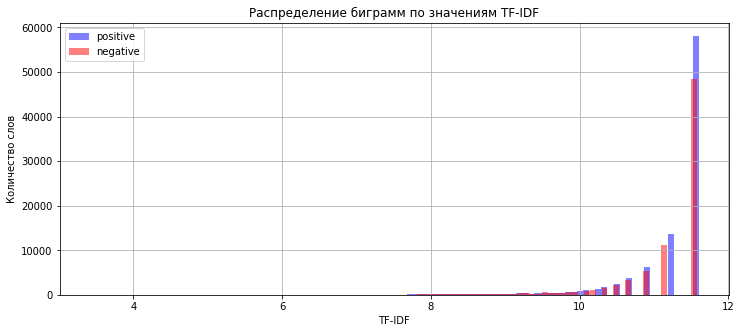

In [82]:
fig = plt.figure(figsize = (12,5))
positive_importance.idf.hist(bins = 100,
                             label = 'positive',
                             alpha = 0.5,
                             color = 'b',
                            )
negative_importance.idf.hist(bins = 100,
                             label = 'negative',
                             alpha = 0.5,
                             color = 'r',
                            )
plt.title('Распределение биграмм по значениям TF-IDF')
plt.xlabel('TF-IDF')
plt.ylabel('Количество слов')
plt.legend()
plt.show()

## Предварительное обучение моделей

In [83]:
# Получим векторные представления текстов
count_idf_1 = TfidfVectorizer(ngram_range=(1,1))

In [84]:
tf_idf_base_1 = count_idf_1.fit(sample_1['text'])
tf_idf_train_base_1 = count_idf_1.transform(train['text'])
tf_idf_test_base_1 = count_idf_1.transform(test['text'])

In [85]:
display(tf_idf_test_base_1.shape)
display(tf_idf_train_base_1.shape)

(68051, 170344)

(158783, 170344)

In [86]:
model_lr_base_1 = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000,
                                    n_jobs= -1)

Получим прогноз и оценим качество модели

In [87]:
model_lr_base_1.fit(tf_idf_train_base_1, train['label'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=12345)

In [88]:
predict_lr_base_proba = model_lr_base_1.predict_proba(tf_idf_test_base_1)

### Сравнение качества классификации на лемматизированных текстах

In [89]:
# Получим векторные представления лемматизированных текстов
count_idf_lemm = TfidfVectorizer(ngram_range=(1,1))

In [90]:
tf_idf_lemm = count_idf_lemm.fit(sample_1['text_lemm'])
tf_idf_train_lemm = count_idf_lemm.transform(train['text_lemm'])
tf_idf_test_lemm = count_idf_lemm.transform(test['text_lemm'])

In [91]:
display(tf_idf_train_lemm.shape)
display(tf_idf_test_lemm.shape)

(158783, 134455)

(68051, 134455)

In [92]:
model_lr_lemm = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000,
                                    n_jobs= -1)

Получим прогноз и оценим качество модели

In [93]:
model_lr_lemm.fit(tf_idf_train_lemm, train['label'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=12345)

In [94]:
predict_lr_lemm_proba = model_lr_lemm.predict_proba(tf_idf_test_lemm)

В качестве сравнения сделаем классификатор который в качестве прогноза выдает случайное число в интервале от 0 до 1 

In [95]:
def coin_classifier(X:np.array) -> np.array:
    predict = np.random.uniform(0.0, 1.0, X.shape[0])
    return predict

In [96]:
coin_predict = coin_classifier(tf_idf_test_base_1)

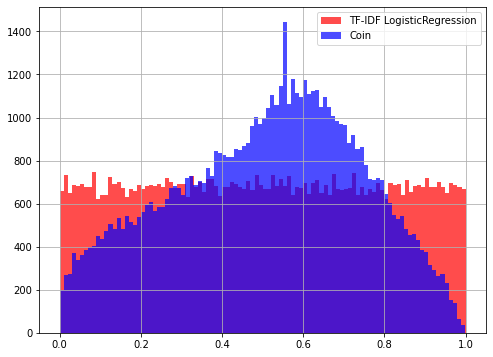

In [97]:
fif = plt.figure(figsize = (8, 6))

pd.Series(coin_predict)\
                .hist(bins = 100,
                      alpha = 0.7,
                      color = 'r',
                      label = 'TF-IDF LogisticRegression'
                     )

pd.Series(predict_lr_base_proba[:, 1])\
                .hist(bins = 100,
                      alpha = 0.7,
                      color = 'b',
                      label = 'Coin'
                     )
plt.legend()   
plt.show()

### Визуализация ROC-кривых классификаторов

In [98]:
fpr_base, tpr_base, _ = roc_curve(test['label'], predict_lr_base_proba[:, 1])
roc_auc_base = auc(fpr_base, tpr_base)

In [99]:
fpr_lemm, tpr_lemm, _ = roc_curve(test['label'], predict_lr_lemm_proba[:, 1])
roc_auc_lemm = auc(fpr_lemm, tpr_lemm)

In [100]:
fpr_coin, tpr_coin, _ = roc_curve(test['label'], coin_predict)
roc_auc_coin = auc(fpr_base, tpr_base)

In [101]:
fig = make_subplots(1,1,
                    subplot_titles = ["Receiver operating characteristic"],
                    x_title="False Positive Rate",
                    y_title = "True Positive Rate"
                   )

fig.add_trace(go.Scatter(
    x = fpr_lemm,
    y = tpr_lemm,
    fill = 'tozeroy',
    name = "ROC lemm (area = %0.3f)" % roc_auc_lemm,
    ))

fig.add_trace(go.Scatter(
    x = fpr_base,
    y = tpr_base,
    #fill = 'tozeroy',
    name = "ROC base (area = %0.3f)" % roc_auc_base,
    ))

fig.add_trace(go.Scatter(
    x = fpr_coin,
    y = tpr_coin,
    mode = 'lines',
    line = dict(dash = 'dash'),
    name = 'Coin classifier (area = 0.5)'
    ))


fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    )

In [102]:
# Выведем матрицы ошибок
confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 1] > 0.5).astype('float'),
                 normalize='true',
                )

array([[0.68629608, 0.31370392],
       [0.22626486, 0.77373514]])

In [103]:
# Выведем матрицу ошибок
confusion_matrix(test['label'],
                 (predict_lr_lemm_proba[:, 1] > 0.5).astype('float'),
                 normalize='true',
                )

array([[0.68362069, 0.31637931],
       [0.23838308, 0.76161692]])

### Визуализация важности признаков

In [104]:
# Получим веса признаков, то есть множители 
# подобранные логистической регрессией 
# для каждого компонента вектора tf-idf

weights = pd.DataFrame({'words': count_idf_1.get_feature_names_out(),
                        'weights': model_lr_base_1.coef_.flatten()})
weights_min = weights.sort_values(by= 'weights')
weights_max = weights.sort_values(by= 'weights', ascending = False)

In [105]:
weights_min = weights_min[:100]
weights_min['weights'] = weights_min['weights'] * -1
weights_min

,words,weights
85419,обидно,6.653885
39067,жаль,6.064990
28964,грустно,5.807029
98823,печально,5.638725
132462,скучаю,5.306973
...,...,...
41049,заболел,2.550300
85711,облом,2.539462
155522,фигово,2.536336
114063,приходится,2.525065


In [106]:
weights_max = weights_max[:100]
weights_max

,words,weights
5503,ахаха,4.517879
5502,ахах,4.404560
20898,вромайдан,4.297034
5539,ахахах,4.185461
86118,обожаю,4.182805
...,...,...
114062,приходите,1.945833
150010,угадал,1.945373
124358,ржал,1.943802
111631,премьера,1.935159


In [107]:
# Воспользуемся библиотекой wordcloud для генерации картинок

wordcloud_positive = WordCloud(background_color="white",
                               colormap = 'Blues',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(weights_max.values))

wordcloud_negative = WordCloud(background_color="black",
                               colormap = 'Reds',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(weights_min.values))

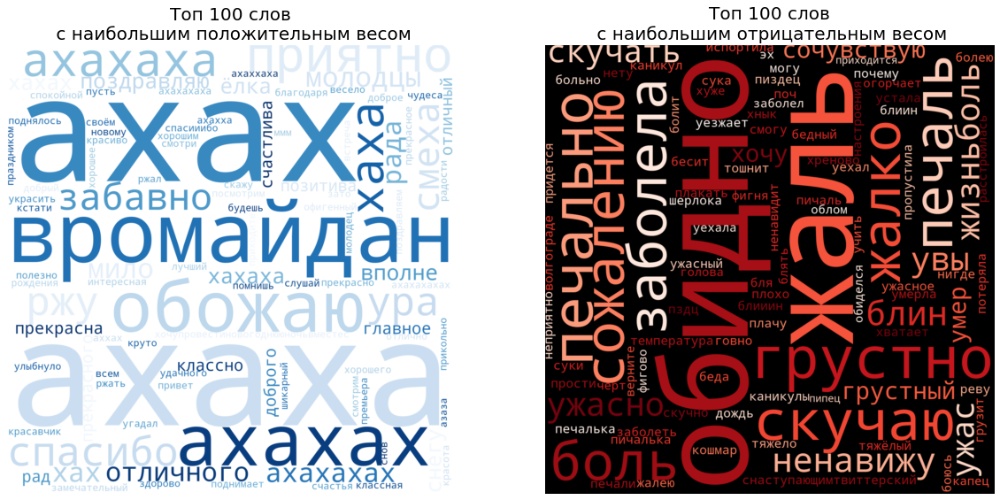

In [108]:
# Выведем картинки сгенерированные вордклаудом
fig, ax = plt.subplots(1, 2, figsize = (20, 12))


ax[0].imshow(wordcloud_positive, interpolation='bilinear')
ax[1].imshow(wordcloud_negative, interpolation='bilinear')

ax[0].set_title('Топ ' +\
                str(weights_max.shape[0]) +\
                ' слов\n с наибольшим положительным весом',
               fontsize = 20
               )
ax[1].set_title('Топ ' +\
                str(weights_min.shape[0]) +\
                ' слов\n с наибольшим отрицательным весом',
               fontsize = 20
               )

ax[0].axis("off")
ax[1].axis("off")

plt.show()

### Снижение размерности признакового пространства модели

In [109]:
fig = make_subplots(1,1)

fig.add_trace(go.Histogram(
    x = weights.query('weights != 0')['weights'],
    #histnorm = 'probability',
    opacity = 0.5,
    showlegend = False
))

fig.add_trace(go.Histogram(
    x = weights.query('weights > 0.25 or weights < -0.25')['weights'],
    #histnorm = 'probability',
    opacity = 0.5,
    showlegend = False
))

fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    
)

In [110]:
vocab = weights.query('weights > 0.25 or weights < -0.25')['words']

In [111]:
vocab

1                ааа
2               аааа
3              ааааа
4             аааааа
5            ааааааа
             ...    
170331           ёще
170334     ёёлочкууу
170339    ёёёлочкааа
170340          ёёёё
170342        ёёёёёё
Name: words, Length: 44579, dtype: object

Получим векторные представления текстов

In [112]:
count_idf = TfidfVectorizer(vocabulary=vocab,
                            ngram_range=(1,8))

In [113]:
tf_idf = count_idf.fit_transform(joned_text['text'])

tf_idf_train = count_idf.transform(train['text'])
tf_idf_test = count_idf.transform(test['text'])

In [114]:
display(tf_idf_test.shape)
display(tf_idf_train.shape)

(68051, 44579)

(158783, 44579)

In [115]:
model_lr_base = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000000000,
                                    n_jobs= -1)

Получим прогноз и оценим качество модели

In [116]:
model_lr_base.fit(tf_idf_train, train['label'])

LogisticRegression(max_iter=10000000000, n_jobs=-1, random_state=12345)

In [117]:
predict_lr_base_proba_1 = model_lr_base.predict_proba(tf_idf_test)
predict_lr_base_proba_1

array([[0.85384058, 0.14615942],
       [0.37675387, 0.62324613],
       [0.7012864 , 0.2987136 ],
       ...,
       [0.29636783, 0.70363217],
       [0.46123782, 0.53876218],
       [0.56641546, 0.43358454]])

In [118]:
fpr_base_1, tpr_base_1, _ = roc_curve(test['label'], predict_lr_base_proba_1[:, 1])
roc_auc_base_1 = auc(fpr_base_1, tpr_base_1)
roc_auc_base_1

0.8028290981290687

In [119]:
fig = make_subplots(1,1,
                    subplot_titles = ["Receiver operating characteristic"],
                    x_title="False Positive Rate",
                    y_title = "True Positive Rate"
                   )

fig.add_trace(go.Scatter(
    x = fpr_base,
    y = tpr_base,
    fill = 'tozeroy',
    name = "ROC curve (area = %0.3f)" % roc_auc_base,
    ))

fig.add_trace(go.Scatter(
    x = fpr_base_1,
    y = tpr_base_1,
    fill = 'tozeroy',
    name = "Less dimensity ROC curve (area = %0.3f)" % roc_auc_base_1,
    ))

fig.add_trace(go.Scatter(
    x = fpr_coin,
    y = tpr_coin,
    mode = 'lines',
    line = dict(dash = 'dash'),
    name = 'Coin classifier'
    ))


fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    )

Вывод:

Мы снизили размерность векторов tf-idf потеряв при этом 0.3% качества (площадь под ROC кривой при размерности > 170К 0.809, площадь под ROC кривой при размерности > 48K -- 0.806)

### Подбор оптимального порогового значения классификации

In [120]:
scores = {}

weight = 0.55

for threshold in np.linspace(0, 1, 100):
    
    matrix = confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 0] <  threshold).astype('float'),
                 normalize='true',
                )

    score = matrix[0,0] * weight + matrix[1,1] * (1 - weight)
    
    scores[threshold] = score

In [121]:
pd.DataFrame({'true_score':scores.values(),
             'threshold':scores.keys()},
             ).sort_values(by = 'true_score', ascending = False).head()

,true_score,threshold
45,0.730878,0.454545
46,0.730328,0.464646
44,0.730276,0.444444
47,0.729790,0.474747
43,0.729172,0.434343


In [122]:
matrix = confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 0] <  0.444444).astype('int'),
                 normalize='true',
                )
matrix

array([[0.77434602, 0.22565398],
       [0.32358839, 0.67641161]])

In [123]:
# Сделаем красивый график матрицы ошибок

fig = make_subplots(1,1)

fig.add_trace(go.Heatmap(
     y = [ 'positive', 'negative'],
     x = ['predicted_negative', 'predicted_positive'],
     z = [matrix[1, :], matrix[0, :]],
     colorscale = 'PuBu'
))

fig.add_trace(go.Heatmap(
     y = [ 'positive', 'negative'],
     x = ['predicted_negative', 'predicted_positive'],
     z = [matrix[1, :], matrix[0, :]],
     colorscale = 'PuBu'
))

fig.add_annotation(x=0, y=0,
            text = "false negative " + str(round(matrix[1,0], 2)),
            showarrow=False,
            font = dict(color = 'black'),
            yshift=10)

fig.add_annotation(x=1, y=1,
            text = "false positive " + str(round(matrix[0,1], 2)),
            showarrow=False,
            font = dict(color = 'black'),
            yshift=10)

fig.add_annotation(x=1, y=0,
            text = "true positive " + str(round(matrix[1,1], 2)),
            showarrow=False,
            font = dict(color = 'white'),
            yshift=10)

fig.add_annotation(x=0, y=1,
            text = "true negative " + str(round(matrix[0,0], 2)),
            showarrow=False,
            font = dict(color = 'white'),
            yshift=10)


fig.update_layout(height = 500,
                  width = 500,
                  template = 'plotly_dark',
                  font_color = 'rgba(212, 210, 210, 1)',
                 ).show()

## Классификация не размеченных комментариев

C помощью обученных tf-idf векторизатора и логистической регрессии получим оценки вероятности негатива в каждом из комментариев

In [124]:
# очистим тексты комментариев под первым видео
start_clean = time.time()

comments_putin_df['text_clear'] = comments_putin_df['comment']\
                                .apply(lambda x: clean_stop_words(clear_text(str(x)), stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 0.03 секунд


In [125]:
# очистим тексты омментариев под вторым видео
start_clean = time.time()

comments_shulman_df['text_clear'] = comments_shulman_df['comment']\
                                .apply(lambda x: clean_stop_words(clear_text(str(x)), stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 0.02 секунд


### Визуализация ключевых слов

In [126]:
shulman_counter = CountVectorizer(ngram_range=(1, 1))
putin_counter = CountVectorizer(ngram_range=(1, 1))

In [127]:
shulman_count = shulman_counter.fit_transform(comments_shulman_df['text_clear'])
putin_count = putin_counter.fit_transform(comments_putin_df['text_clear'])

In [128]:
shulman_count.toarray().sum(axis = 0).shape

(3673,)

In [129]:
shulman_counter.get_feature_names_out().shape

(3673,)

In [130]:
# Сохраним списки Idf для каждого класса
shulman_frequence = pd.DataFrame(
    {'word' : shulman_counter.get_feature_names_out(),
     'frequency' : shulman_count.toarray().sum(axis = 0)
    }).sort_values(by = 'frequency', ascending = False)

putin_frequence = pd.DataFrame(
    {'word' : putin_counter.get_feature_names_out(),
     'frequency' : putin_count.toarray().sum(axis = 0)
    }).sort_values(by = 'frequency', ascending = False)

display(shulman_frequence.shape[0])
display(putin_frequence.shape[0])

3673

5238

In [131]:
putin_frequence = putin_frequence.query('word not in @shulman_importance.word')[:100]

UndefinedVariableError: local variable 'shulman_importance' is not defined

In [133]:
shulman_frequence = shulman_frequence.query('word not in @putin_frequence.word')[:100]

In [ ]:
# Воспользуемся библиотекой wordcloud для генерации картинок

wordcloud_shulman = WordCloud(background_color="black",
                               colormap = 'Blues',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(putin_frequence.values))

wordcloud_putin = WordCloud(background_color="black",
                               colormap = 'Oranges',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(shulman_frequence.values))

NameError: name 'wordcloud_shulman' is not defined

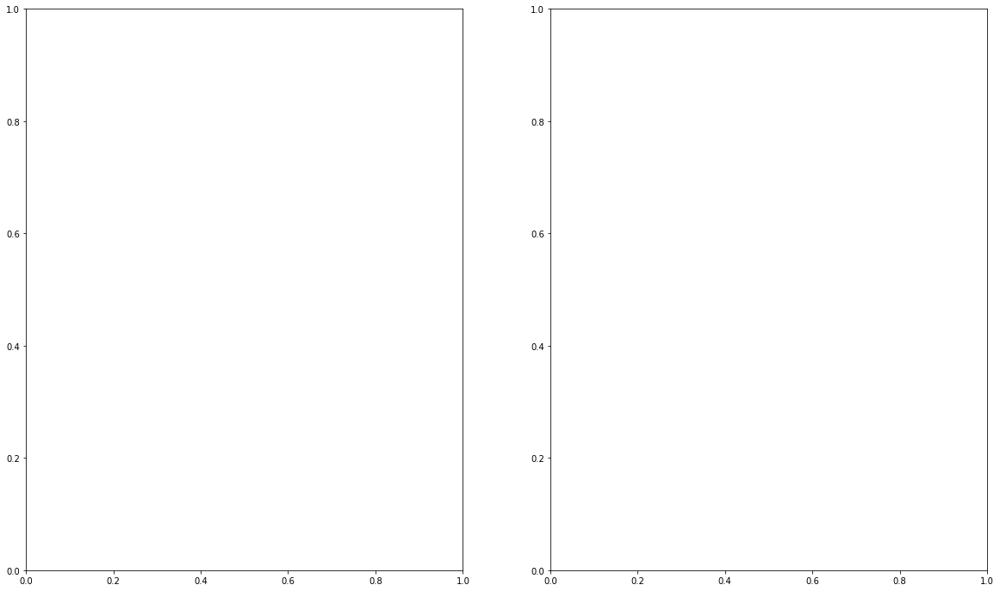

In [132]:
# Выведем картинки сгенерированные вордклаудом
fig, ax = plt.subplots(1, 2, figsize = (20, 12))


ax[0].imshow(wordcloud_shulman, interpolation='bilinear')
ax[1].imshow(wordcloud_putin, interpolation='bilinear')

ax[0].set_title('Топ ' +\
                str(shulman_frequence.shape[0]) +\
                ' слов наиболее частотных,\n ' +\
                ' уникальных слов в комментариях\n' +\
                ' под поздравлением В. Путина',
               fontsize = 20
               )
ax[1].set_title('Топ ' +\
                str(putin_frequence.shape[0]) +\
                ' слов наиболее частотных,\n ' +\
                ' уникальных слов в комментариях\n' +\
                'под поздравлением Е. Шульман',
               fontsize = 20
               )

ax[0].axis("off")
ax[1].axis("off")

plt.show()

## Получение оценки негативности комментария

In [136]:
# Выведем 5 случайных комментариев c оценкой негатива первого видео
for _ in range(5):

    source = comments_putin_df.sample(n=1)
    text_clear = source['text_clear'].values[0]
    text = source['comment'].values[0]

    print(text)

    tf_idf_text = count_idf.transform([text_clear])

    toxic_proba = model_lr_base.predict_proba(tf_idf_text)

    print('Вероятность негатива: ', toxic_proba[:, 0])
    print()

,Unnamed: 0,comment,text_clear
602,602,Это был трудный год.... как и предыдущие двад...,это трудный год предыдущие двадцать лет следую...


In [137]:
# Выведем 5 случайных комментариев c оценкой негатива второго видео
for _ in range(5):

    source = comments_shulman_df.sample(n=1)
    text_clear = source['text_clear'].values[0]
    text = source['comment'].values[0]

    print(text)

    tf_idf_text = count_idf.transform([text_clear])

    toxic_proba = model_lr_base.predict_proba(tf_idf_text)

    print('Вероятность негатива: ', toxic_proba[:, 0])
    print()

С новым годом вас, здоровья, успехов и благополучия, будьте счастливы!!!!
Вероятность негатива:  [0.30705542]

Ну это прям спасение какое-то, честно сказать весь день думал, как не смотреть деда и что смотреть вместо него?!!
Вероятность негатива:  [0.34967679]

Очень своевременно!) Спасибо большущее! С Новым годом! 
Вероятность негатива:  [0.56525381]

С наступающим - милая Екатерина ! 
Вероятность негатива:  [0.50882008]

Невероятная умница Екатерина! Дарит крылья, силу, веру в себя и оптимизм! Спасибо Вам! И наилучшие пожелания! За Вами хочется идти!
Вероятность негатива:  [0.44656825]



In [138]:
# Получим оценки негатива для всех комментариев первого и второго видео

putin_tf_idf = count_idf.transform(comments_putin_df['text_clear'])
shulman_tf_idf = count_idf.transform(comments_shulman_df['text_clear'])

putin_negative_proba = model_lr_base.predict_proba(putin_tf_idf)
shulman_negative_proba = model_lr_base.predict_proba(shulman_tf_idf)

comments_putin_df['negative_proba'] = putin_negative_proba[:, 0]
comments_shulman_df['negative_proba'] = shulman_negative_proba[:, 0]

Найдем доли негативных комментариев при оптимальном пороговом значении

In [139]:
putin_share_neg = (comments_putin_df['negative_proba'] > 0.44).sum() / comments_putin_df.shape[0]
putin_share_neg

0.5475478468899522

In [140]:
shulman_share_neg = (comments_shulman_df['negative_proba'] > 0.44).sum() / comments_shulman_df.shape[0]
shulman_share_neg

0.35048802129547474

In [141]:
fig = make_subplots(1,1,
                   subplot_titles=['Распределение комментариев по оценке негативности']     
                   )

fig.add_trace(go.Violin(
    x = comments_shulman_df['negative_proba'],
    meanline_visible = True,
    name = 'Shulman (N = %i)' % comments_putin_df.shape[0],
    side = 'positive',
    spanmode = 'hard'
))



fig.add_trace(go.Violin(
    x = comments_putin_df['negative_proba'],
    meanline_visible = True,
    name = 'Putin (N = %i)' % comments_shulman_df.shape[0],
    side = 'positive',
    spanmode = 'hard'
))


fig.add_annotation(x=0.8, y=1.5,
            text = "%0.2f — доля негативных комментариев (при p > 0.44)"\
                   % putin_share_neg,
            showarrow=False,
            yshift=10)

fig.add_annotation(x=0.8, y=0.5,
            text = "%0.2f — доля негативных комментариев (при p > 0.44)"\
                   % shulman_share_neg,
            showarrow=False,
            yshift=10)

fig.update_traces(orientation='h', 
                  width = 1.5,
                  points = False
                 )


fig.update_layout(height = 500,
                  #xaxis_showgrid=False,
                  xaxis_zeroline=False,
                  template = 'plotly_dark',
                  font_color = 'rgba(212, 210, 210, 1)',
                  legend=dict(
                    y=0.9,
                    x=-0.1,
                    yanchor='top',
                    ),
                 )
fig.update_yaxes(visible = False)
              


fig.show()

# Тест

In [142]:
text = ['недавно из-за этой ямы была сильная Авария! ', 'куда неоднократно попадают машины и лишаются колёс , недавно из-за этой ямы была сильная Авария! ','Главная нерешенная проблема это ты','Там кстати есть свой Кремль', 'Даже захотелось съездить, познакомиться с Сызранью.', 'Почему на набережной нет деревьев? В из тени можно укрыться от палящего солнца. Ой. Можно было бы😉\nВ Самаре такая же история, непонятная🤷\u200d♀️', 'Чудесная набережная! Получила огромное удовольствие, прогуливаясь вчера по ней! Жители Тольятти позавидовали бы!)', 'Очень радостно за земляков! Спасибо, Дмитрий Игоревич, что обо всех заботитесь💚', 'Дмитрий Игоревич, спасибо большое, что вы делаете, для нашей Губернии, ну хотелось бы обратится с просьбой о помощи Новой - Вокзальной тупик 15 "А", общежитие, рядом новостройки, за общежитием детская площадка, жильцы выливают мочу, кидают, всяческий мусор, бычки с окна, по ночам в выходные  сидят с торца, всё оплёвано бычков намеренно, дети до 5 утра не спят, разрисовывают, ломают вахту, кидают везде мусор, на замечания хамят, отнекиваются, как бороться с такими людьми, и их детьми, понятно, что люди с низкой социальной ответственностью, ну надо принимать меры, этой ночью они расцарапали машину, на вахте валялись подожжёные квитанции, то бутылки с водой с окон бросают, то бычки  с окна летят, когда будут  ужесточать закон в отношение таких людей, они чувствуют свою безнаказанность, а нормальным людям жить не дают, пожалуйста примите Меры!', 'Сызрань, соседи, поздравляем!)))) Ни разу у вас не были, но тоже захотелось приехать в гости. Набережная по фото, действительно, красивая 😍', 'Здравствуйте! Набережная есть, хорошая, красивая с современными детскими площадками, а вот где парковка? Грунтовая парковка, в дождь месиво, и это центр города! Почему-то на фотографии ее не показали ))) очень живописно выглядит!', 'Дмитрий Игоревич, пройдите по улице Венцека... и дом губернатора... почему это не реставрируют? Часть домов в личное пользование с сохранением и реставрацией. Все эти механизмы давно известны и давно описаны. Туризм в области действительно развивается, спасибо Вам.', 'Здравствуйте! Только сегодня говорили о том, что набережная прекрасная, гуляющих и отдыхающих "море", а био-туалеты закрыты, работают 2, но их не убирают, невозможно зайти, смрад. Куда бежать людям и детям? Где те службы, что должны следить за чистотой и гигиеной туалетов (раз уж их поставили, то нужно и следить)? И ещё вопрос! Речь о  городском пляже! Столько лет никак не решат вопрос с маршрутным транспортом! Так неудобно добираться до него, такой путь идти. Неужели нельзя пустить на лето маршрут? Такси очень дорого!', 'Здравствуйте , когда отремонтируют дорогу в городе Новокуйбышевск ул. Промышленная , знаки дорожных работ стоят уже три месяца , а дорога ,как была с ямами ,так и есть, хочу отметить ,что по этой дороге работают городские маршруты и люди добираются с других городов по этой же дороге , протяженность необслужанной дороги составляет не менее 1км , чтобы по ней проехать безопасно для транспорта и пассажиров , водители снижают скорость до 5 км/ч. Когда обратите внимание на эту богом забытую дорогу ???', 'Да, туристический потенциал как в Турции.', 'На набережной, должно было быть построено ,, Детское шахматное Королевство". Россия стала бы ,, Шахматной державой".  Но проект не поддержали, глава ФИДЕ Серпер, и помощница его с салатовым Айфоном Наталья ( ну эта вообще подарок, в какой только одежде не являлась, Ну а проводили ,... ) Уже видно..сдержали Россию,  город, область в развитии. Слепили простую, пускай боле-менее красивую детскую игровую площадку на набережной. Завалили погремушками, путь развития Сызрани в России для России. \n Понятно одно , решает тут,  только Дмитрий Игоревич. Значит надо к губернатору.\n А остальное все сорняк под ногами. Мешает идти России к развитию...', 'Я очень горжусь тем, что город наш - Сызрань преображается !!! 👍😊', 'Какая красивая набережная 👍', 'Отчёт по тратам 215 млн тоже будет известен простым гражданам?', 'Добрый день! Около дома по улице 22 партсъезда около дома 227 огромная яма , куда неоднократно попадают машины и лишаются колёс , недавно из-за этой ямы была сильная Авария! Когда сделают дорогу ?', 'Поздравляю Сызранцев! !!! ❤❤❤', 'А кафедральный за счёт бюджета тоже?', '[id142921363|Владимир], прям да.', 'А почему нельзя вновь запустить завод Пластик? Где же импортщамещение?', 'Кода будет проверка УК Финстрой, Новая Самара, очень много жалоб, никто не реагирует', 'Не плохо с сызрани !!!фото не плохое!', 'Здравствуйте, обращаемся к Вам с коллективной жалобой от жильцов дома по ул. Воронежская 208 \nПросим вас повлиять на данную ситуацию, так как жить так дальше невозможно!\nПо всему подъезду бегают тараканы!\nВ 4-м подъезде в подвале завелось 10 щенят и в добавок к тараканам появились блохи, они жутко кусаются!!!\nВ подъезде живут молодые семьи с детьми, беременные женщины.\nОгромная просьба в самые ближайшие сроки принять меры, потому что это все предоставляет опасность для здоровья каждого из нас!', 'Дмитрий Игоревич, пишу вам второй раз, от лица всех неравнодушных болельщиков крыльев советов , после каждой игры, видно что наш селекция в одном месте, но не возможно, пожалуйста разберитесь  хоть как то на руководство селекционного отдела и на само руководство, были проданы ключевые игроки вместо них взяты молодые без опыта игроки, мы просто уже устали и хотим видеть любимую команду какая она была эти 2 года (( так министерство спорта Самары сразу вам отвечу сделайте встречу с болельщиками или организуйте что то, почему команда отдалилась от болельщиков!!!!! Дмитрий Игоревич ждём ваших действий!!!!']
text_clear =  ['недавно из-за этой ямы была сильная Авария! ', 'куда неоднократно попадают машины и лишаются колёс , недавно из-за этой ямы была сильная Авария! ','Главная нерешенная проблема это ты','кстати свой кремль ,', 'захотеться съездить познакомиться сызрань ,', 'почему набережная дерево из тень укрываться палящий солнце ой быть в самара такой история непонятный ,', 'чудесный набережная получать огромный удовольствие прогуливаться вчера она житель тольятти позавидовать ,', 'очень радостно земляк спасибо дмитрий игоревич обо заботиться ,', 'дмитрий игоревич спасибо большой вы делать наш губерния хотеться обращаться просьба помощь новый вокзальный тупик общежитие рядом новостройка общежитие детский площадка жилец выливать моча кидать всяческий мусор бычок окно ночь выходной сидеть торец все оплевывать бычок намеренно ребенок утро спать разрисовывать ломать вахта кидать везде мусор замечание хамить отнекиваться бороться такой человек они ребенок понятно человек низкий социальный ответственность надо принимать мера ночь расцарапывать машина вахта валяться подожженый квитанция бутылка вода окно бросать бычок окно лететь быть ужесточать закон отношение такой человек чувствовать безнаказанность нормальный человек жить давать пожалуйста принимать мера ,', 'сызрань сосед поздравлять раз вы быть тоже захотеться приезжать гость набережная фото действительно красивый ,', 'здравствовать набережная хороший красивый современный детский площадка вот парковка грунтовый парковка дождь месиво это центр город почему на фотография не показывать очень живописный выглядеть ,', 'дмитрий игоревич проходить улица венцек дом губернатор почему это реставрировать часть дом личный пользование сохранение реставрация этот механизм давно известный давно описывать туризм область действительно развиваться спасибо ,', 'здравствовать сегодня говорить то набережная прекрасный гулять отдыхающий море био туалет закрывать работать убирать невозможно зайти смрад бежать человек ребенок тот служба должный следить чистота гигиена туалет уж они поставлять нужно следить еще вопрос речь городской пляж столько год никак решать вопрос маршрутный транспорт неудобно добираться он путь идти неужели пускать лето маршрут такси очень дорого ,', 'здравствовать отремонтировать дорога город новокуйбышевск ул промышленный знак дорожный работа стоять три месяц дорога быть яма хотеть отмечать дорога работать городской маршрут человек добираться другой город по этот дорога протяженность необслужанна дорога составлять мало по проехать безопасно транспорт и пассажир водитель снижать скорость км ч обращать внимание этот бог забытый дорога ,', 'туристический потенциал в турция ,', 'набережная должно быть построить детский шахматный королевство россия становиться шахматный держава проект поддерживать глава фид серпер помощница с салатовый айфон наталья этот вообще подарок какой одежда являться проводить видно сдерживать россия город область развитие слепить простой пускай боле менее красивый детский игровой площадка набережная заваливать погремушка путь развитие сызрань россия россия понятно один решать только дмитрий игоревич значит губернатор а остальное сорняк нога мешать идти россия к развитие ,', 'очень гордиться что город наш сызрань преображаться ,', 'красивый набережная ,', 'отчет трата млн быть известный простой гражданин ,', 'добрый день около дом улица партсъезд около дом огромный яма неоднократно попадать машина лишаться колесо недавно за яма сильный авария сделать дорога ,', 'поздравлять сызранец ,', 'кафедральный счет бюджет ,', 'владимир прямой ,', 'почему вновь запускать завод пластик же импортщамещение ,', 'код проверка ук финстрой новый самара очень жалоба никто реагировать ,', 'плохо сызрань фото плохой ,', 'здравствовать обращаться вы коллективный жалоба жилец дом ул воронежский просить повлиять данный ситуация как жить далеко невозможно весь подъезд бегать таракан м подъезд подвал заводиться щенок добавка таракан появляться блоха жутко кусаться подъезд жить молодой семья ребенок беременный женщина огромный просьба в самый близкий срок принимать мера что это предоставлять опасность здоровье каждый мы ,', 'дмитрий игоревич писать второй лицо неравнодушный болельщик крыло совет каждый игра видно наш селекция один место не возможно пожалуйста разбираться как на руководство селекционный отдел на сам руководство продавать ключевой игрок вместо взять молодой опыт игрок просто уставать хотеть видеть любимый команда она этот год министерство спорт самара сразу отвечать сделать встреча болельщик организовывать то почему команда отдаляться от болельщик дмитрий игоревич ждать ваш действие ,']


text_long_comment  = ['Добрый день! Около дома по улице 22 партсъезда около дома 227 огромная яма , куда неоднократно попадают машины и лишаются колёс , недавно из-за этой ямы была сильная Авария! Когда сделают дорогу ?']
text_long_comment_clear = []


data_set = pd.DataFrame({'comment':text, 'text_clear': text_clear})
data_set.loc[19]

comment       Добрый день! Около дома по улице 22 партсъезда...
text_clear    добрый день около дом улица партсъезд около до...
Name: 19, dtype: object

In [143]:
# Выведем 5 случайных комментариев c оценкой негатива второго видео
for _ in range(20):

    source = data_set.sample(n=1)
    text_clear = source['text_clear'].values[0]
    text = source['comment'].values[0]

    print(text)

    tf_idf_text = count_idf.transform([text_clear])

    toxic_proba = model_lr_base.predict_proba(tf_idf_text)

    print('Вероятность негатива: ', toxic_proba[:, 0])
    print()

Дмитрий Игоревич, пишу вам второй раз, от лица всех неравнодушных болельщиков крыльев советов , после каждой игры, видно что наш селекция в одном месте, но не возможно, пожалуйста разберитесь  хоть как то на руководство селекционного отдела и на само руководство, были проданы ключевые игроки вместо них взяты молодые без опыта игроки, мы просто уже устали и хотим видеть любимую команду какая она была эти 2 года (( так министерство спорта Самары сразу вам отвечу сделайте встречу с болельщиками или организуйте что то, почему команда отдалилась от болельщиков!!!!! Дмитрий Игоревич ждём ваших действий!!!!
Вероятность негатива:  [0.21972]

Дмитрий Игоревич, пройдите по улице Венцека... и дом губернатора... почему это не реставрируют? Часть домов в личное пользование с сохранением и реставрацией. Все эти механизмы давно известны и давно описаны. Туризм в области действительно развивается, спасибо Вам.
Вероятность негатива:  [0.26328015]

Кода будет проверка УК Финстрой, Новая Самара, очень мн